# Advanced Lane Line Project
The goal of this project is to write a software pipeline to identify the lane boundaries in a video. In order to do so, the following steps will by applyied:

1. compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
2. apply a distortion correction to raw images.
3. use color transforms, gradients, etc., to create a thresholded binary image.
4. apply a perspective transform to rectify binary image ("birds-eye view").
5. detect lane pixels and fit to find the lane boundary.
6. determine the curvature of the lane and vehicle position with respect to center.
7. warp the detected lane boundaries back onto the original image.
8. output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import glob

from Camera import Camera
from Thresholds import Thresholds
%matplotlib inline

## Utilities
`print_images` takes as input a string representing a folder and print all the images inside that folder

In [2]:
def print_images(folder, columns = 2):
    images = glob.glob(folder + '/*.jpg')
    if (len(images) % columns) == 0:
        rows = len(images)//columns
    else:
        rows = (len(images) + 1)//columns
    f, axes = plt.subplots(rows, columns, figsize=(40,110))
    i = 0
    for fname in images:
        img = cv2.imread(fname)
        axes.flat[i].imshow(img)
        axes.flat[i].set_title(fname, fontsize=40)
        i += 1
    if (len(images) % columns) != 0:
        f.delaxes(axes[-1][-1])
    plt.show()

`plot_image` takes an image and plot it

In [3]:
def plot_image(img, title='Image'):
    f, ax = plt.subplots(1, 1, figsize=(12,9))
    ax.imshow(img, cmap='gray')
    ax.set_title(title, fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.show()

`draw_lines_on_road` draws the lane found with all the calculation back on the original image

In [4]:
def draw_lines_on_road(original_image, binary_warped):
    left_fitx, right_fitx, ploty = l.get_poly_plot()
    h,w = binary_warped.shape
    warp_zero = np.zeros_like(binary_warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))
    
    ploty = np.linspace(0, h-1, num=h)# to cover same y-range as image
    
    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))
    cv2.polylines(color_warp, np.int32([pts_left]), isClosed=False, color=(255,0,255), thickness=15)
    cv2.polylines(color_warp, np.int32([pts_right]), isClosed=False, color=(0,255,255), thickness=15)

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = b.unwarp(color_warp)
    # Combine the result with the original image
    result = cv2.addWeighted(original_image, 1, newwarp, 0.5, 0)
    return result

`draw_overlay` draws curvature and distance on the image given in input

In [18]:
def draw_overlay(image, curvature, distance):
    font = cv2.FONT_HERSHEY_DUPLEX
    cv2.putText(image,"Radius of Curvature:  "+ '{:6.2f}km'.format(curvature), (10, 50), font, 1.0,[255, 255, 255], 1, cv2.LINE_AA)
    if distance > 0:
        cv2.putText(image,"Vehicle is " + '{:6.2f}m'.format(distance) + " right of center", (10, 100), font, 1.0,[255, 255,255], 1, cv2.LINE_AA)
    else:
        cv2.putText(image,"Vehicle is " + '{:6.2f}m'.format(distance) + " left of center", (10, 100), font, 1.0,[255, 255, 255], 1, cv2.LINE_AA)
    return image

## 1. Compute the camera calibration matrix and distortion coefficients given a set of chessboard images

In order to undistort the images, first we need the camera calibration matrix and distortion coefficient. These are found by taking pictures of a chessboard (in our case a 9x6 chessboard) and then applying the function `cv2.calibrateCamera`. 
The chessboard images can be found in the folder `camera_cal`. 
Note that some images are not perfect, and the chessboard is 'cut', thus the function `cv2.findChessboardCorners` cannot find all the corners. All the code that calibrates the camera, and also the function that undistort the image that we are going to use in point 2, can be found in the Python class `Camera` (defined in Camera.py)

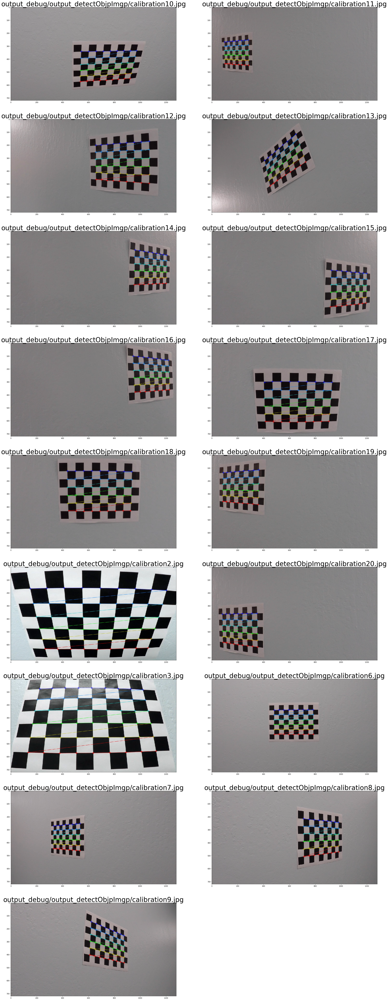

In [78]:
# Uncomment next to test camera calibration
# c = Camera()
# c.calibrate(debug=True)
# axes = print_images(r'output_debug/output_detectObjpImgp')

## 2. Apply a distortion correction to raw images
Call Camera's method `undistort` to undistort images.
Function `debug_undistort` simply call `undistort` method an all the calibration images.

In [4]:
def debug_undistort():
    c = Camera()
    c.calibrate()
    camera_images = glob.glob('camera_cal/*.jpg')
    for fname in camera_images:
        img = cv2.imread(fname)
        undistorted = c.undistort(img)
        outfname = fname.replace('camera_cal', 'output_debug/output_undistorted')
        f, axes = plt.subplots(1, 2, figsize=(20,10))
        axes.flat[0].imshow(img)
        axes.flat[0].set_title(fname, fontsize=40)
        axes.flat[1].imshow(undistorted)
        axes.flat[1].set_title('Undistorted', fontsize=40)
        cv2.imwrite(outfname, undistorted)
        confront_out = fname.replace('camera_cal', 'output_debug/confront_undistorted')
        f.savefig(confront_out)

# Uncomment to try undistortion
# debug_undistort()

## 3. Use color transforms, gradients, etc., to create a thresholded binary image
Class Thresholds (defined in Thresholds.py) is a class that let the user extract features from the image by thresholding Sobel, HLS Colorspace and others. The main function is `combine` that, as the name suggests, combines all the features selected so as to create a thresholded binary image.

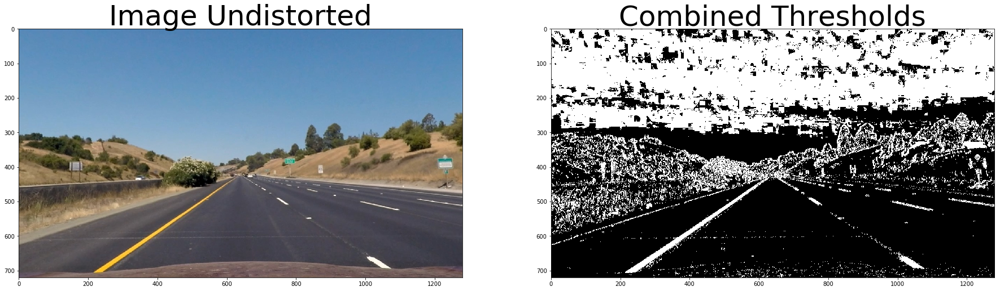

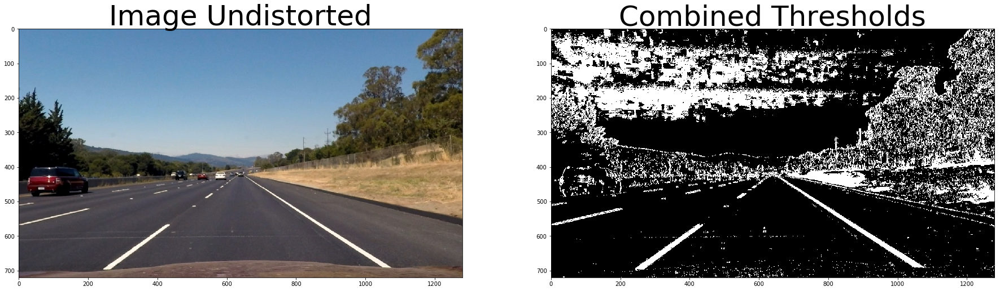

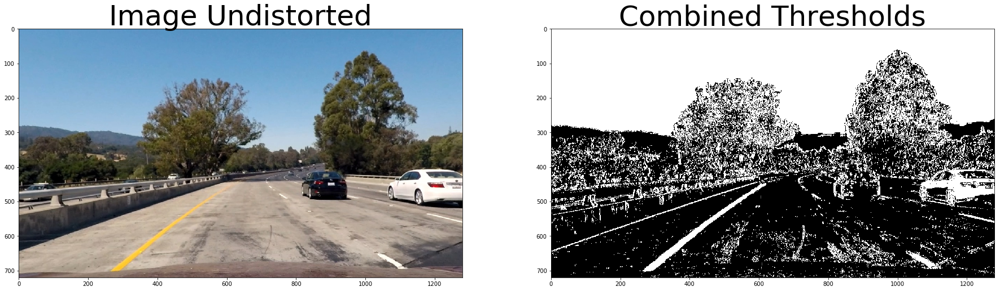

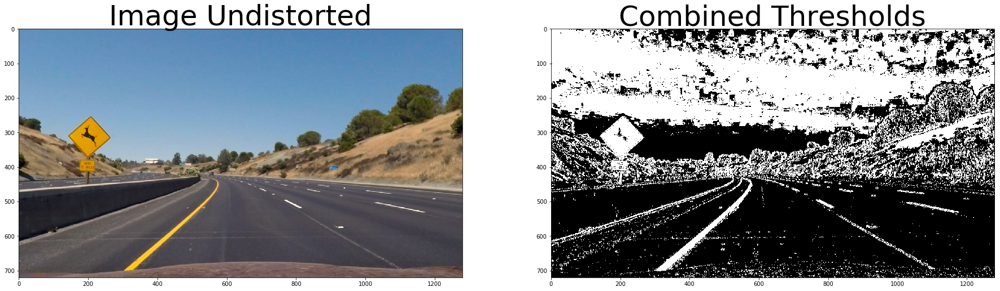

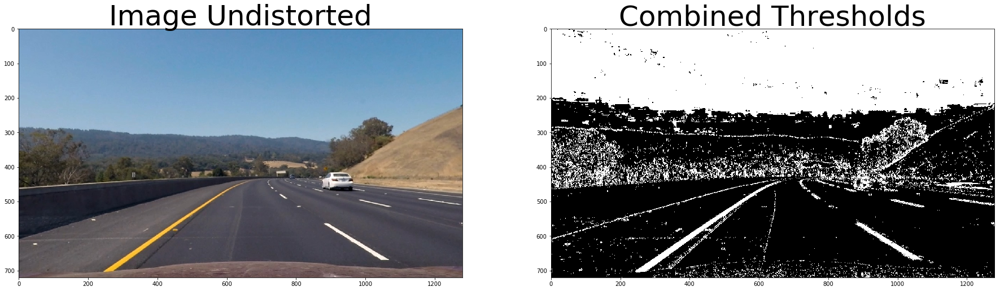

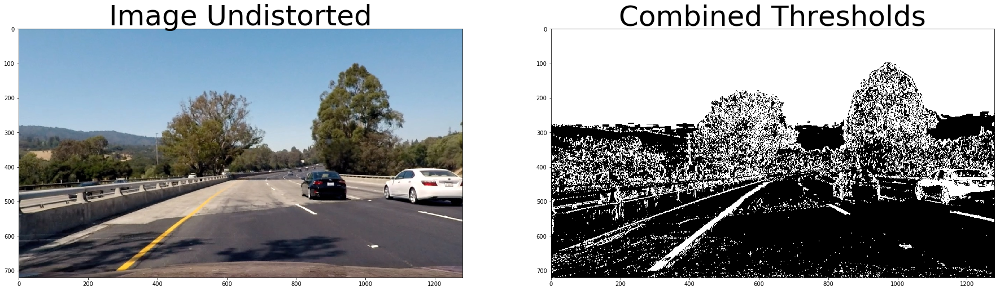

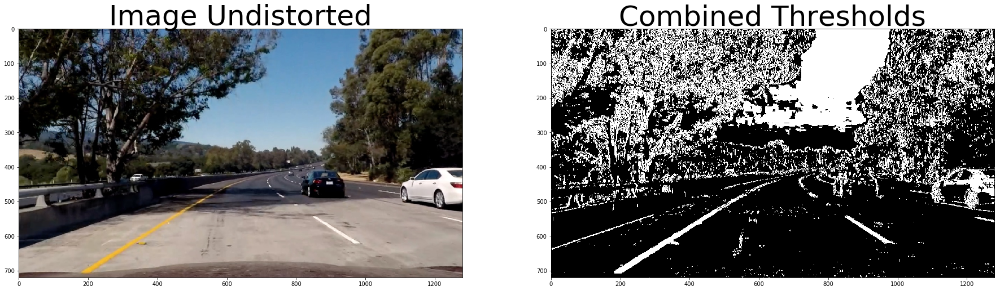

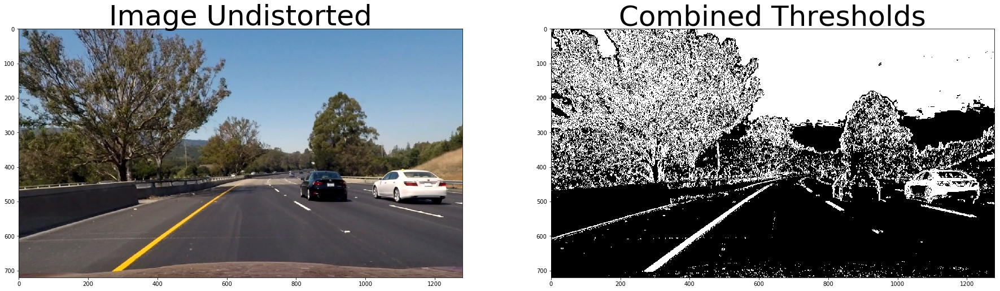

In [36]:
c = Camera()
c.calibrate()
t = Thresholds()
images = glob.glob('test_images/*.jpg') 

for index, fname in enumerate(images):
    image = c.undistort(cv2.imread(fname))
    combined = t.combine(image)
    
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    ax1.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    ax1.set_title('Image Undistorted', fontsize=50)
    ax2.imshow(combined, cmap='gray')
    ax2.set_title('Combined Thresholds', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.show()


## 4. Apply a perspective transform to rectify binary image ("birds-eye view")

In [6]:
class BirdEyeView_Transform:
    def __init__(self):
        SRC_LEFT_BOTTOM = (150, 720)
        SRC_RIGHT_BOTTOM = (1250, 720)
        SRC_LEFT_UP = (590, 450)
        SRC_RIGHT_UP = (700, 450)
        
        DST_LEFT_BOTTOM = (200, 720)
        DST_RIGHT_BOTTOM = (980, 720)
        DST_LEFT_UP = (200, 0)
        DST_RIGHT_UP = (980, 0)    
        
        self._src = np.array([[SRC_LEFT_BOTTOM , SRC_LEFT_UP, SRC_RIGHT_UP, SRC_RIGHT_BOTTOM]], dtype=np.float32)
        self._dst = np.array([[DST_LEFT_BOTTOM , DST_LEFT_UP, DST_RIGHT_UP, DST_RIGHT_BOTTOM]], dtype=np.float32)
        self._M = cv2.getPerspectiveTransform(self._src, self._dst)
        self._Minv = cv2.getPerspectiveTransform(self._dst, self._src)
        
    def roi(self, image):
        mask = np.zeros_like(image)
        ignore_mask_color = 255

        #filling pixels inside the polygon defined by \"vertices\" with the fill color
        cv2.fillPoly(mask, np.int32(self._src), ignore_mask_color)

        #returning the image only where mask pixels are nonzero
        masked_image = cv2.bitwise_and(image, mask)
        return masked_image

    def warp(self, image):
        y = image.shape[0]
        x = image.shape[1]
        return cv2.warpPerspective(image, self._M, (x, y), flags=cv2.INTER_LINEAR)
                             
    def unwarp(self, image):
        y = image.shape[0]
        x = image.shape[1]
        return cv2.warpPerspective(image, self._Minv, (x, y), flags=cv2.INTER_LINEAR)

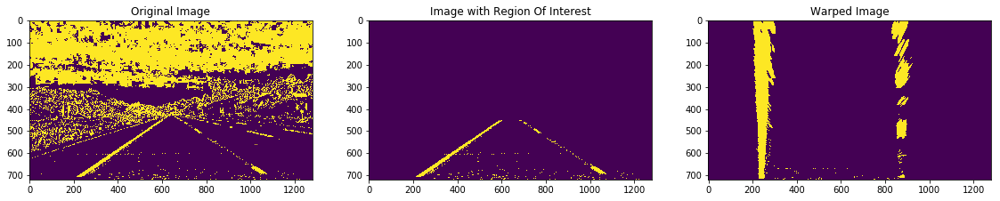

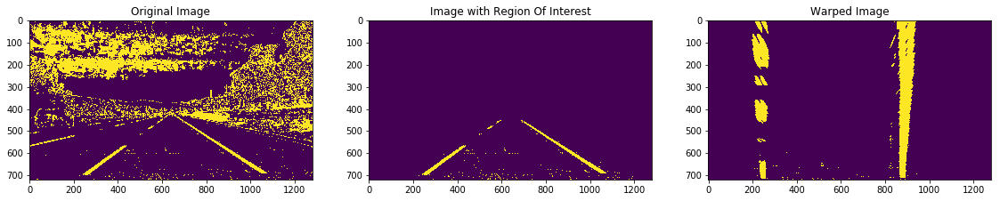

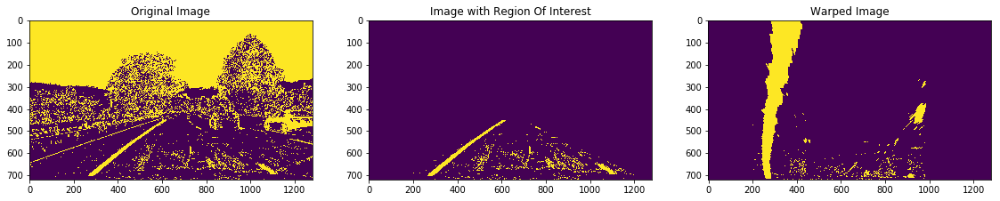

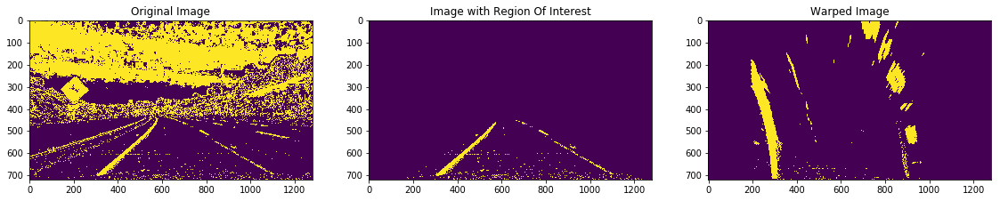

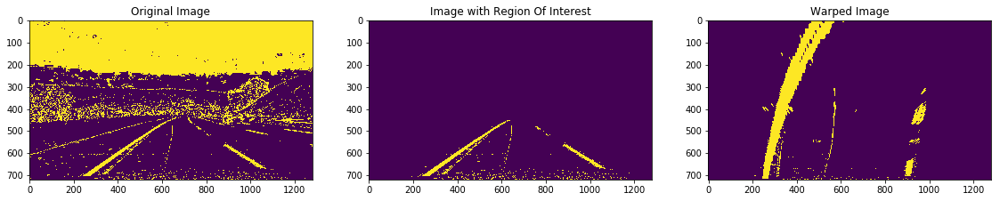

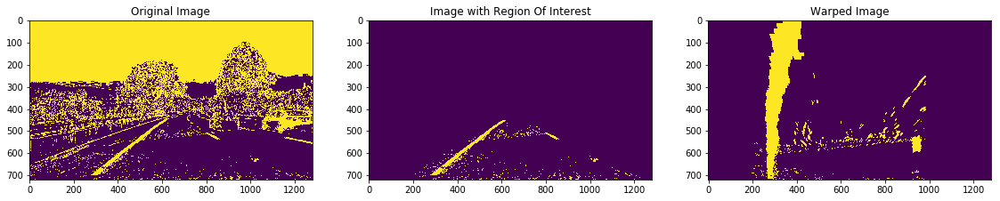

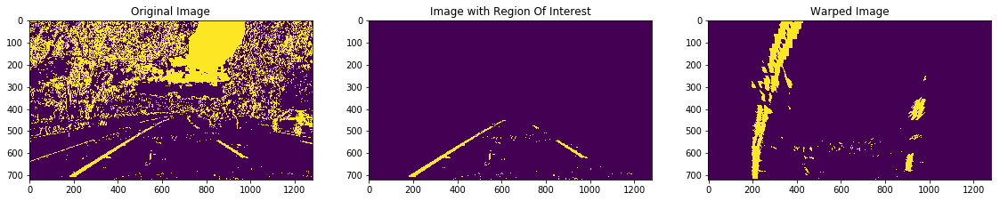

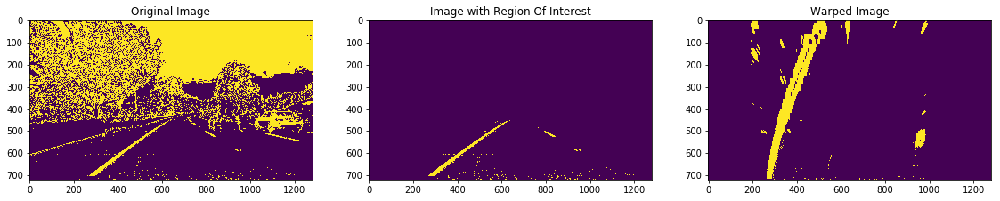

In [22]:
images = glob.glob('test_images/*.jpg') 

c = Camera()
c.calibrate()
t = Thresholds()
b = BirdEyeView_Transform()

for index, fname in enumerate(images):
    image = cv2.imread(fname)
    image = c.undistort(image)
    image = t.combine(image)
    roi = b.roi(image)
    warped = b.warp(roi)
    
    f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 30))
    ax1.imshow(image)
    ax1.set_title('Original Image')
    ax2.imshow(roi)
    ax2.set_title('Image with Region Of Interest')
    ax3.imshow(warped)
    ax3.set_title('Warped Image')
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.show()

## 5. Detect lane pixels and fit to find the lane boundary

In [7]:
import numpy.polynomial.polynomial as poly
class Lanes:
    def __init__(self):
        # HYPERPARAMETERS
        # Number of sliding windows
        self._NWINDOWS = 9
        # Set the width of the windows +/- margin
        self._WINDOWMARGIN = 100
        # Set minimum number of pixels found to recenter window
        self._MINPIX = 50
        
        # Width of the margin around the previous polynomial to search
        self._POLYMARGIN = 100
        
        self._YM_PER_PIX = 30/720 # meters per pixel in y dimension
        self._XM_PER_PIX = 3.7/700 # meters per pixel in x dimension
        
        self._first = True
        
        self._Y_EVAL = 719 # Evaluate Curvature at car level
        
        self._CENTER_CAR = 640 # Center of the car is approximately 640

    
    def findLanes(self, image, debug=False):
        if self._first:
            print("Find lane pixels")
            self.find_lane_pixels(image, debug)
            self._first = False
        else:
            print("Search around poly")
            self.search_around_poly(image, debug)
    
    # Code from lessons' material
    def histogram(self, image):
        return np.sum(image[image.shape[0]//2:,:], axis=0)
    
    # Code from lessons' material
    def find_lane_pixels(self, image, debug=False):
        histogram = self.histogram(image)
        self._image_shape = image.shape
        if debug:
            # Create an output image to draw on and visualize the result
            self.out_img = np.dstack((image, image, image))
            
        # Find the peak of the left and right halves of the histogram
        # These will be the starting point for the left and right lines
        midpoint = np.int(histogram.shape[0]//2)
        leftx_base = np.argmax(histogram[:midpoint])
        rightx_base = np.argmax(histogram[midpoint:]) + midpoint

        # Set height of windows - based on nwindows above and image shape
        window_height = np.int(image.shape[0]//self._NWINDOWS)
        # Identify the x and y positions of all nonzero pixels in the image
        nonzero = image.nonzero()
        nonzeroy = np.array(nonzero[0])
        nonzerox = np.array(nonzero[1])
        # Current positions to be updated later for each window in nwindows
        leftx_current = leftx_base
        rightx_current = rightx_base

        # Create empty lists to receive left and right lane pixel indices
        left_lane_inds = []
        right_lane_inds = []

        # Step through the windows one by one
        for window in range(self._NWINDOWS):
            # Identify window boundaries in x and y (and right and left)
            win_y_low = image.shape[0] - (window+1)*window_height
            win_y_high = image.shape[0] - window*window_height
            # Find the four below boundaries of the window
            win_xleft_low = leftx_current - self._WINDOWMARGIN  
            win_xleft_high = leftx_current + self._WINDOWMARGIN  
            win_xright_low = rightx_current - self._WINDOWMARGIN 
            win_xright_high = rightx_current + self._WINDOWMARGIN 

            if debug:
                # Draw the windows on the visualization image
                cv2.rectangle(self.out_img,(win_xleft_low,win_y_low), (win_xleft_high,win_y_high), (0,255,0), 2) 
                cv2.rectangle(self.out_img,(win_xright_low,win_y_low), (win_xright_high,win_y_high), (0,255,0), 2) 

            # Identify the nonzero pixels in x and y within the window
            good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
            (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
            good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
            (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]

            # Append these indices to the lists
            left_lane_inds.append(good_left_inds)
            right_lane_inds.append(good_right_inds)

            # If you found > minpix pixels, recenter next window 
            # (`right` or `leftx_current`) on their mean position 
            if len(good_left_inds) > self._MINPIX:
                leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
            if len(good_right_inds) > self._MINPIX:        
                rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

        # Concatenate the arrays of indices (previously was a list of lists of pixels)
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
    
        self._leftx = nonzerox[left_lane_inds]
        self._lefty = nonzeroy[left_lane_inds] 
        self._rightx = nonzerox[right_lane_inds]
        self._righty = nonzeroy[right_lane_inds] 
        self.fit_poly()
        
        if debug:
            self.out_img[self._lefty, self._leftx] = [255, 0, 0]
            self.out_img[self._righty, self._rightx] = [0, 0, 255]
    
    def fit_poly(self):
        self._left_fit = np.polyfit(self._lefty, self._leftx, 2)
        self._right_fit = np.polyfit(self._righty, self._rightx, 2)
        self._left_fit_cr = np.polyfit(self._lefty*self._YM_PER_PIX, self._leftx*self._XM_PER_PIX, 2)
        self._right_fit_cr = np.polyfit(self._righty*self._YM_PER_PIX, self._rightx*self._XM_PER_PIX, 2)
    
    def get_poly_plot(self):
        # Generate x and y values for plotting
        ploty = np.linspace(0, self._image_shape[0]-1, self._image_shape[0])
        ### Calc both polynomials using ploty, left_fit and right_fit
        left_fitx = self._left_fit[0]*ploty**2 + self._left_fit[1]*ploty + self._left_fit[2]
        right_fitx = self._right_fit[0]*ploty**2 + self._right_fit[1]*ploty + self._right_fit[2]
        return left_fitx, right_fitx, ploty
    
    # Code from lessons' material
    # Second
    def search_around_poly(self, image, debug=False):
        self._image_shape = image.shape
        # Grab activated pixels
        nonzero = image.nonzero()
        nonzeroy = np.array(nonzero[0])
        nonzerox = np.array(nonzero[1])
        
        # Set the area of search based on activated x-values
        # within the +/- margin of our polynomial function
        left_poly = self._left_fit[0]*(nonzeroy**2) + self._left_fit[1]*nonzeroy + self._left_fit[2]
        right_poly = self._right_fit[0]*(nonzeroy**2) + self._right_fit[1]*nonzeroy + self._right_fit[2]
        left_lane_inds = ((nonzerox > (left_poly - self._POLYMARGIN)) & (nonzerox < (left_poly + self._POLYMARGIN)))
        right_lane_inds = ((nonzerox > (right_poly - self._POLYMARGIN)) & (nonzerox < (right_poly + self._POLYMARGIN)))

        # Again, extract left and right line pixel positions
        self._leftx = nonzerox[left_lane_inds]
        self._lefty = nonzeroy[left_lane_inds] 
        self._rightx = nonzerox[right_lane_inds]
        self._righty = nonzeroy[right_lane_inds] 
        self.fit_poly()
        
        if debug:
            self.out_img = np.dstack((image, image, image))*255
            self.out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
            self.out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
            
    def curvature(self):
        left_curverad = ((1 + (2*self._left_fit_cr[0]*self._Y_EVAL*self._YM_PER_PIX + self._left_fit_cr[1])**2)**1.5) / np.absolute(2*self._left_fit_cr[0])
        right_curverad = ((1 + (2*self._right_fit_cr[0]*self._Y_EVAL*self._YM_PER_PIX + self._right_fit_cr[1])**2)**1.5) / np.absolute(2*self._right_fit_cr[0])
        return (left_curverad + right_curverad)/2
    
    def car_center_distance(self):   
        left_fit = np.flip(self._left_fit,0)
        right_fit = np.flip(self._right_fit,0)
        leftl = poly.polyval(self._Y_EVAL, left_fit)
        rightl = poly.polyval(self._Y_EVAL, right_fit)

        # Midpoint Y_EVAL is center of the road
        center_road = (rightl + leftl)/2
        distance  = (self._CENTER_CAR - center_road)*self._XM_PER_PIX

        return distance

Fname  test_images/straight_lines1.jpg


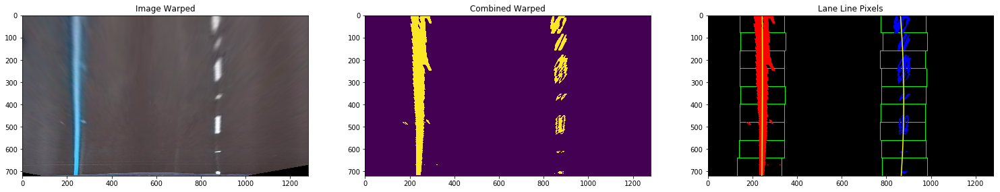

Fname  test_images/straight_lines1.jpg


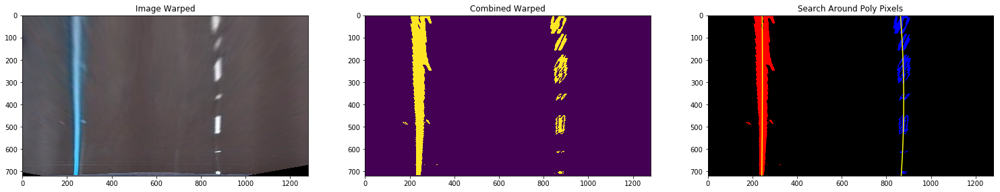

Fname  test_images/straight_lines2.jpg


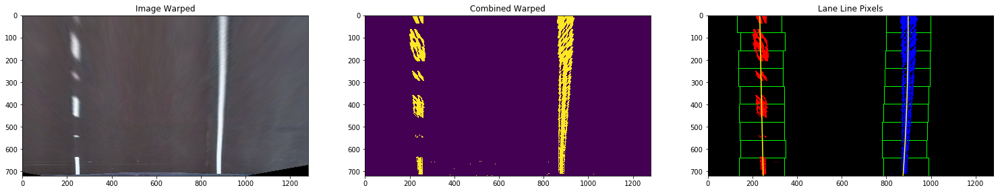

Fname  test_images/straight_lines2.jpg


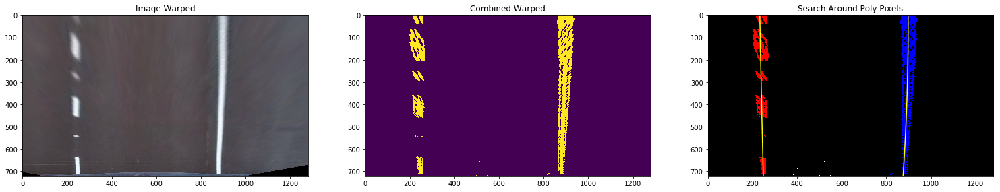

Fname  test_images/test1.jpg


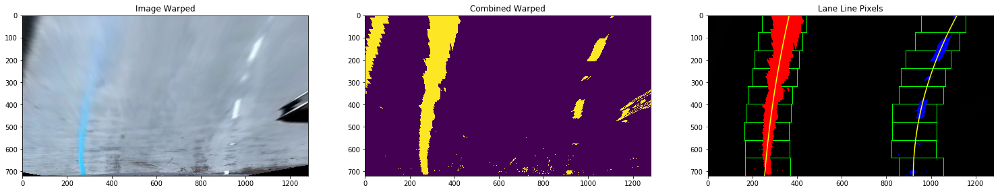

Fname  test_images/test1.jpg


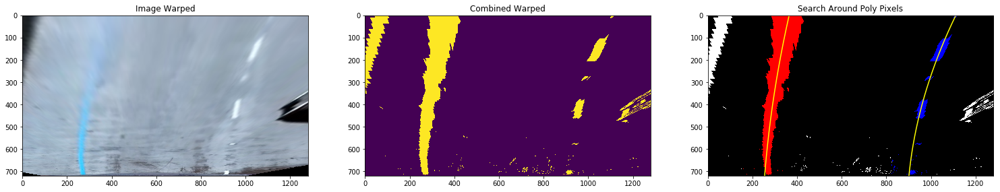

Fname  test_images/test2.jpg


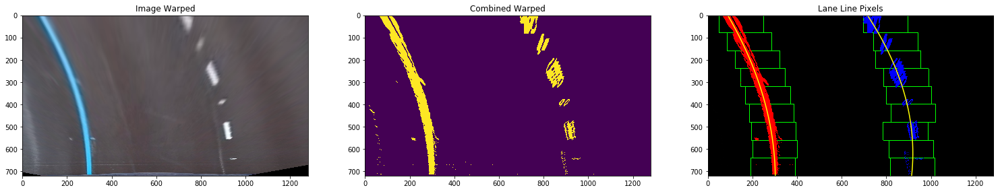

Fname  test_images/test2.jpg


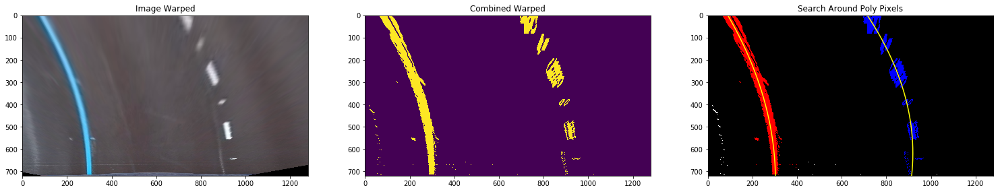

Fname  test_images/test3.jpg


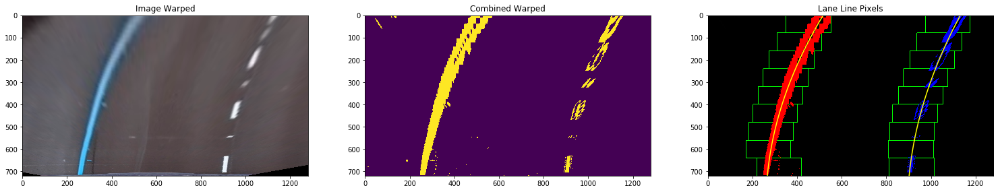

Fname  test_images/test3.jpg


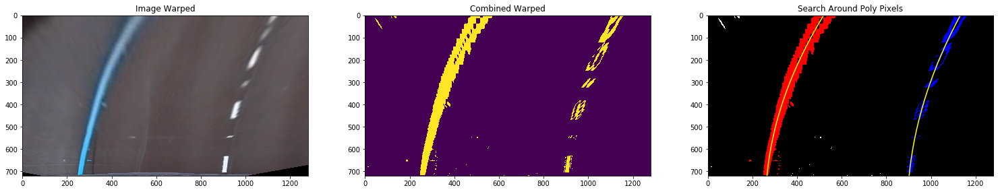

Fname  test_images/test4.jpg


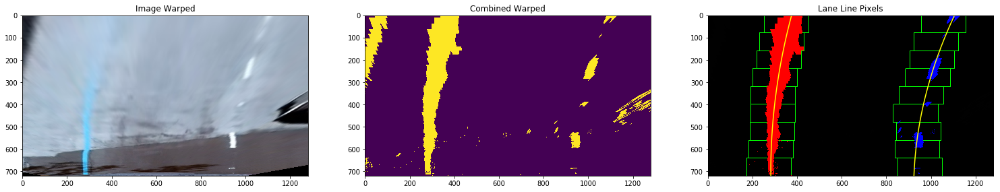

Fname  test_images/test4.jpg


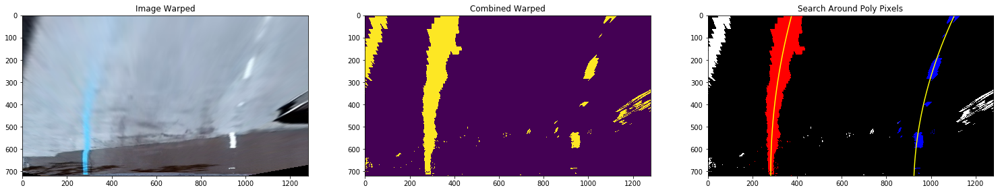

Fname  test_images/test5.jpg


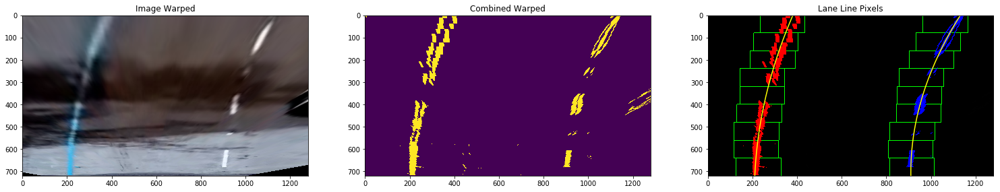

Fname  test_images/test5.jpg


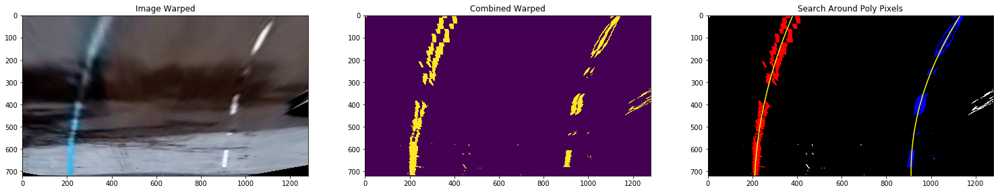

Fname  test_images/test6.jpg


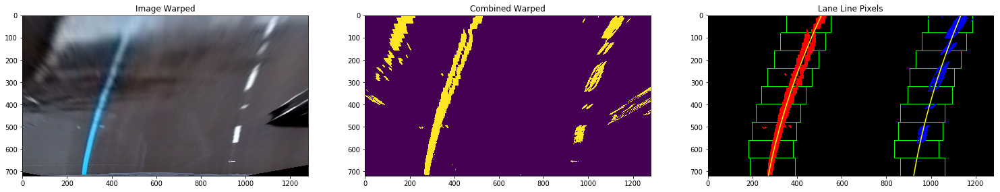

Fname  test_images/test6.jpg


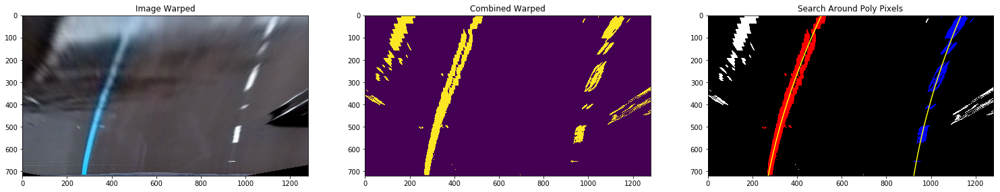

In [27]:
# Testing Histogram
images = glob.glob('test_images/*.jpg') 

c = Camera()
c.calibrate()
t = Thresholds()
b = BirdEyeView_Transform()
l = Lanes()

def test_histogram(fname):
    image = cv2.imread(fname)
    image = c.undistort(image)
    combined = t.combine(image)
    roi = b.roi(combined)
    image_warped = b.warp(image)
    combined_warped = b.warp(combined)
#     combined_warped = b.warp(roi) # Tried to cut a roi, but performance where not so good
    histogram = l.histogram(combined_warped)
    
    f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(20, 10))
    ax1.imshow(image_warped)
    ax1.set_title('Image Warped')
    ax2.imshow(combined_warped)
    ax2.set_title('Combined Warped')
    ax3.plot(histogram)
    ax3.set_title('Histogram')
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.show()
    
def test_find_lane_pixels(fname):
    image = cv2.imread(fname)
    image = c.undistort(image)
    combined = t.combine(image)
#     roi = b.roi(combined)
    image_warped = b.warp(image)
    combined_warped = b.warp(combined)
#     combined_warped = b.warp(roi) # Tried to cut a roi, but performance where not so good
    l.find_lane_pixels(combined_warped, True)
    left_fitx, right_fitx, ploty = l.get_poly_plot()
    
    print("Fname ", fname)
    f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(20, 10))
    ax1.imshow(image_warped)
    ax1.set_title('Image Warped')
    ax2.imshow(combined_warped)
    ax2.set_title('Combined Warped')
    ax3.imshow(l.out_img)
    ax3.plot(left_fitx, ploty, color='yellow')
    ax3.plot(right_fitx, ploty, color='yellow')
    ax3.set_title('Lane Line Pixels')
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.show()
    
def test_search_around_poly(fname):
    image = cv2.imread(fname)
    image = c.undistort(image)
    combined = t.combine(image)
#     roi = b.roi(combined)
    image_warped = b.warp(image)
    combined_warped = b.warp(combined)
#     combined_warped = b.warp(roi) # Tried to cut a roi, but performance where not so good
    l.search_around_poly(combined_warped, True)
    left_fitx, right_fitx, ploty = l.get_poly_plot()
    
    print("Fname ", fname)
    f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(20, 10))
    ax1.imshow(cv2.cvtColor(image_warped, cv2.COLOR_BGR2RGB))
    ax1.set_title('Image Warped')
    ax2.imshow(combined_warped)
    ax2.set_title('Combined Warped')
    ax3.imshow(l.out_img)
    ax3.plot(left_fitx, ploty, color='yellow')
    ax3.plot(right_fitx, ploty, color='yellow')
    ax3.set_title('Search Around Poly Pixels')
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.show()
    
for index, fname in enumerate(images):
#     test_histogram(fname)
    test_find_lane_pixels(fname)
    test_search_around_poly(fname)

## 6. Determine the curvature of the lane and vehicle position with respect to center.

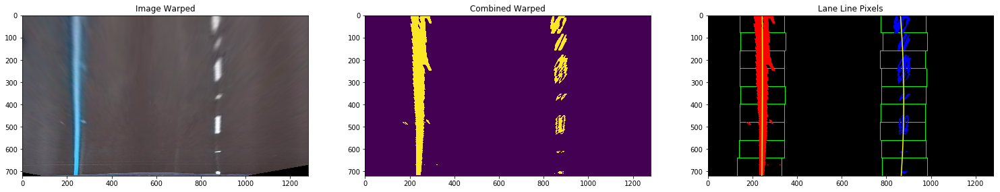

Fname  test_images/straight_lines1.jpg
Curvature =  7535
Distance =  0.452934671988
-----------------------


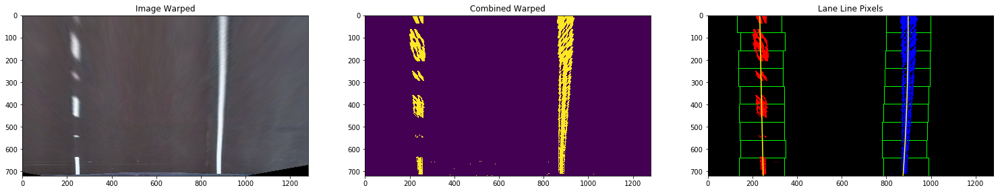

Fname  test_images/straight_lines2.jpg
Curvature =  20767
Distance =  0.413599970311
-----------------------


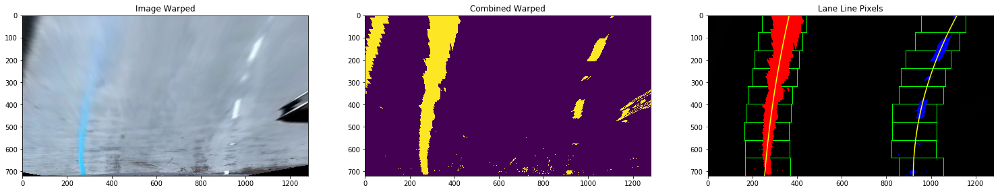

Fname  test_images/test1.jpg
Curvature =  1030
Distance =  0.276757247514
-----------------------


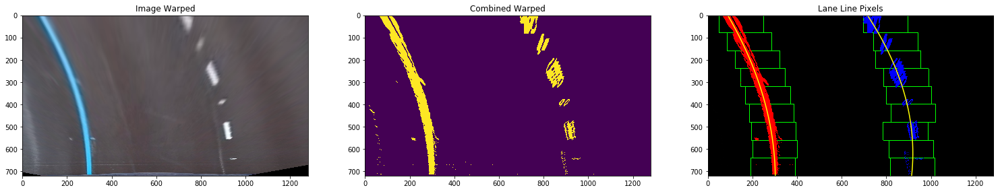

Fname  test_images/test2.jpg
Curvature =  363
Distance =  0.169450903877
-----------------------


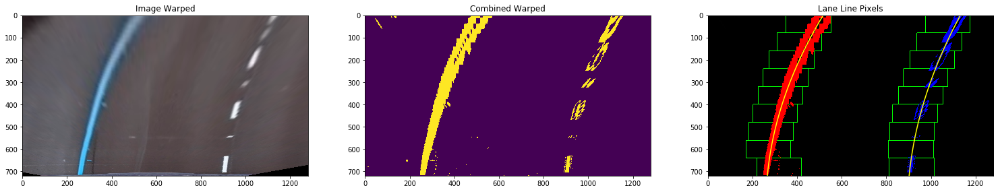

Fname  test_images/test3.jpg
Curvature =  501
Distance =  0.293368379834
-----------------------


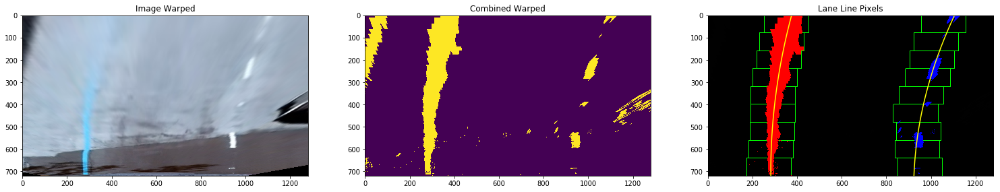

Fname  test_images/test4.jpg
Curvature =  708
Distance =  0.195297224738
-----------------------


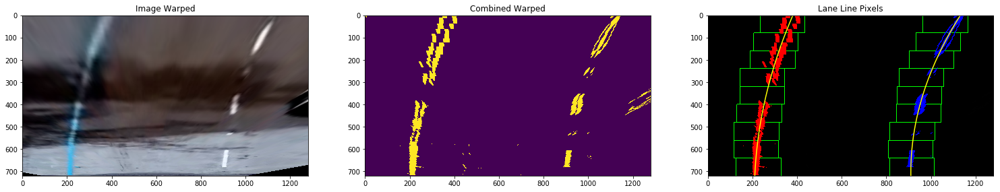

Fname  test_images/test5.jpg
Curvature =  489
Distance =  0.421378017651
-----------------------


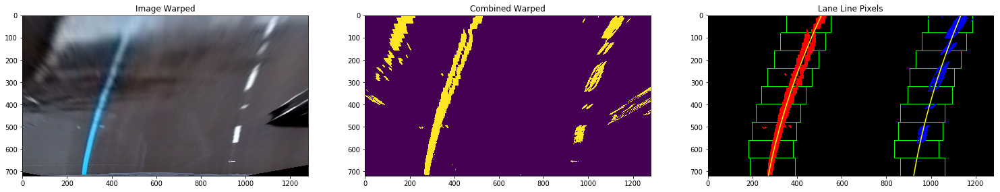

Fname  test_images/test6.jpg
Curvature =  918
Distance =  0.226973746447
-----------------------


In [33]:
# Testing Histogram
images = glob.glob('test_images/*.jpg') 

c = Camera()
c.calibrate()
t = Thresholds()
b = BirdEyeView_Transform()
l = Lanes()

def test_curvature_car_distance(fname):
    image = cv2.imread(fname)
    image = c.undistort(image)
    combined = t.combine(image)
    image_warped = b.warp(image)
    combined_warped = b.warp(combined)
    l.find_lane_pixels(combined_warped, True)
    curvature = l.curvature()
    car_distance = l.car_center_distance()
    left_fitx, right_fitx, ploty = l.get_poly_plot()
    
    f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(20, 10))
    ax1.imshow(cv2.cvtColor(image_warped, cv2.COLOR_BGR2RGB))
    ax1.set_title('Image Warped')
    ax2.imshow(combined_warped)
    ax2.set_title('Combined Warped')
    ax3.imshow(l.out_img)
    ax3.plot(left_fitx, ploty, color='yellow')
    ax3.plot(right_fitx, ploty, color='yellow')
    ax3.set_title('Lane Line Pixels')
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.show()
    print("Fname ", fname)
    print("Curvature = ", int(curvature))
    print("Distance = ", car_distance)
    print("-----------------------")
    
for index, fname in enumerate(images):
    test_curvature_car_distance(fname)

## 7. Warp the detected lane boundaries back onto the original image

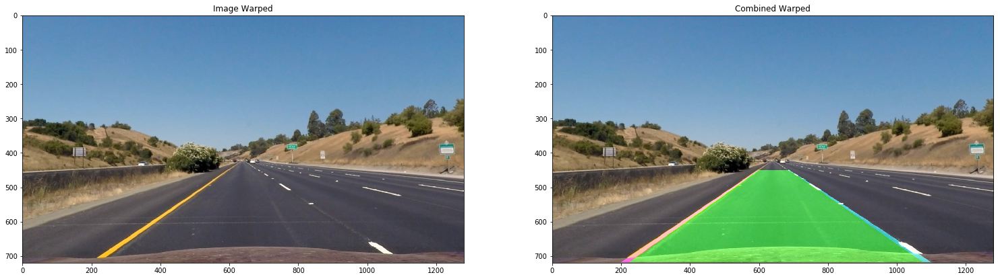

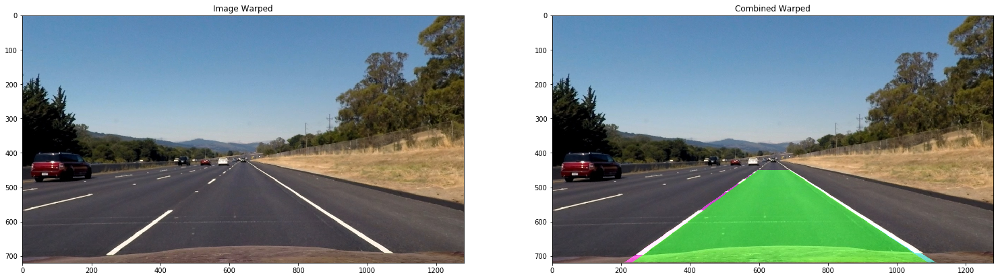

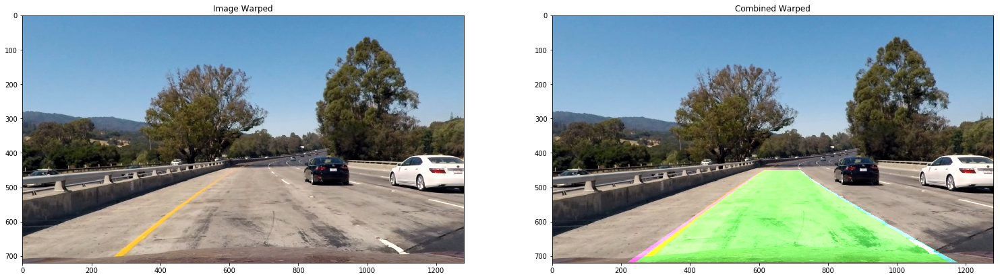

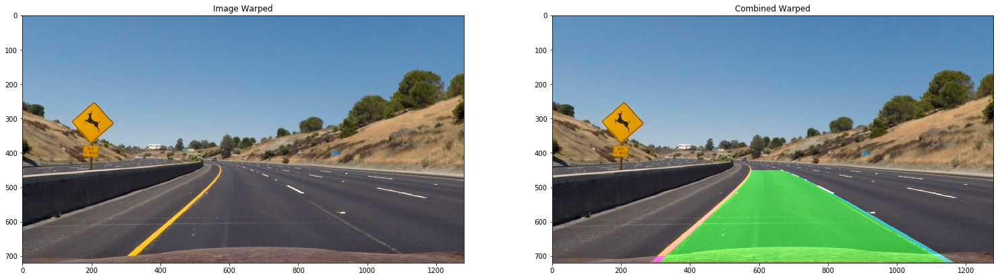

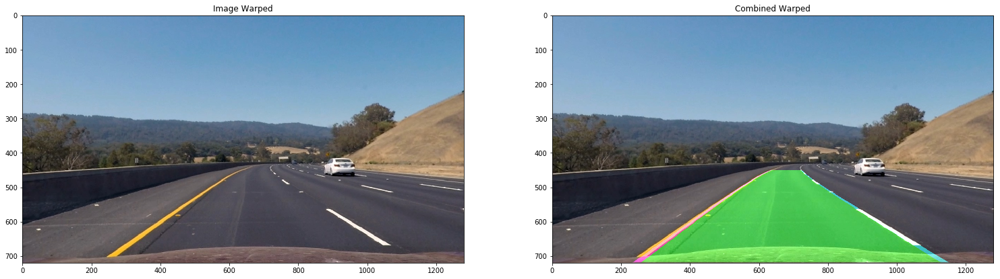

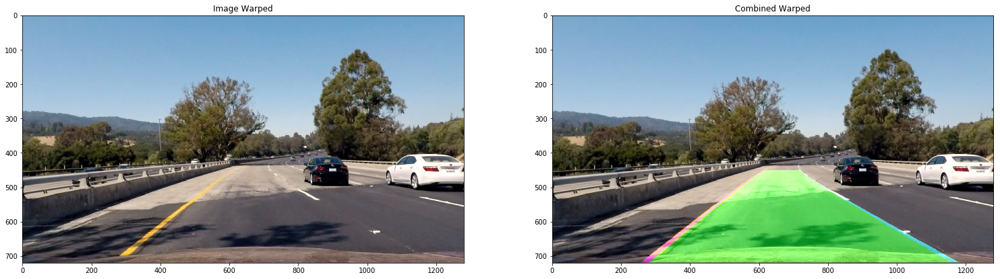

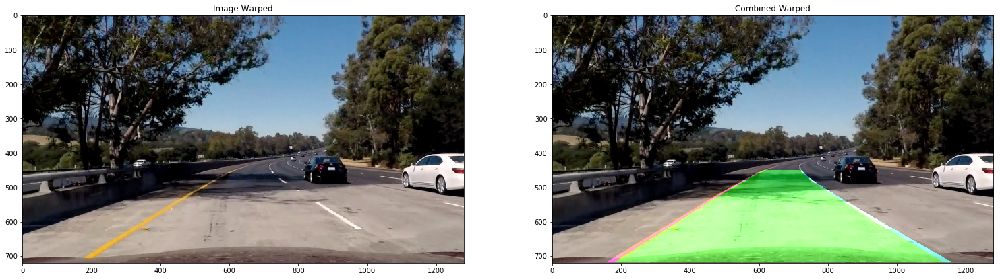

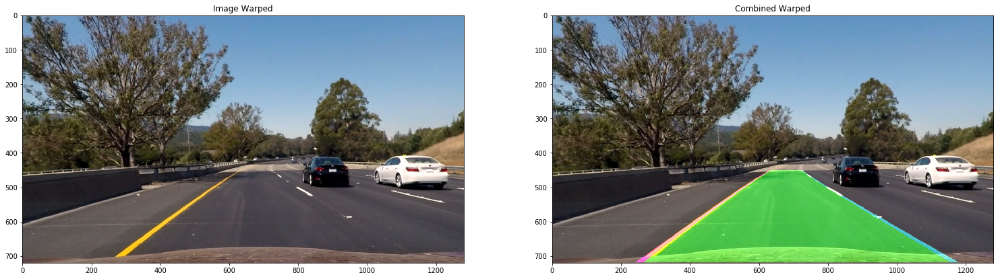

In [35]:
images = glob.glob('test_images/*.jpg') 

c = Camera()
c.calibrate()
t = Thresholds()
b = BirdEyeView_Transform()
l = Lanes()

def test_draw_lines_on_road(fname):
    image = cv2.imread(fname)
    image = c.undistort(image)
    combined = t.combine(image)
    image_warped = b.warp(image)
    combined_warped = b.warp(combined)
    l.find_lane_pixels(combined_warped, True)
    
    left_fitx, right_fitx, ploty = l.get_poly_plot()
    
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
    ax1.imshow(image)
    ax1.set_title('Image Warped')
    ax2.imshow(draw_lines_on_road(image, combined_warped))
    ax2.set_title('Combined Warped')
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.show()
    
for index, fname in enumerate(images):
    test_draw_line(fname)

## 8. Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position

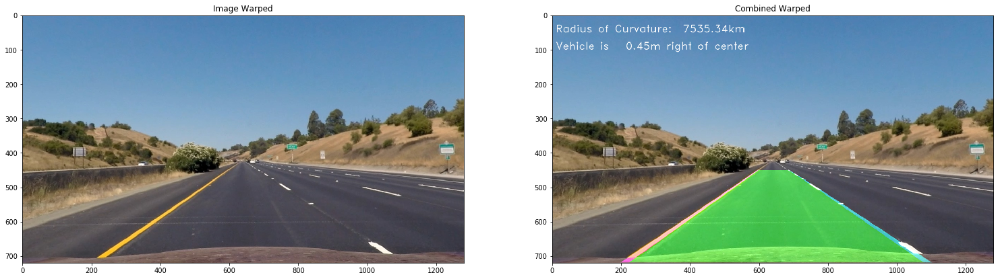

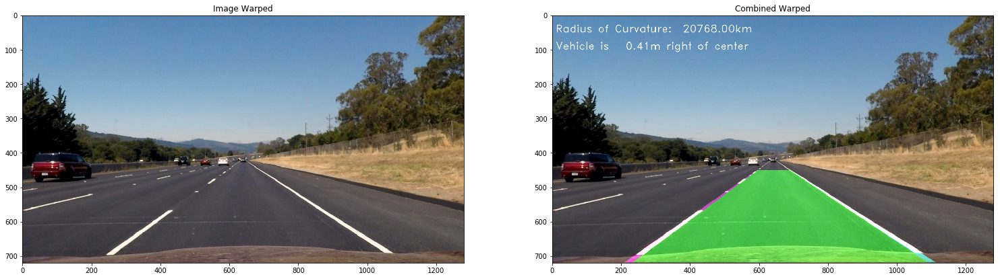

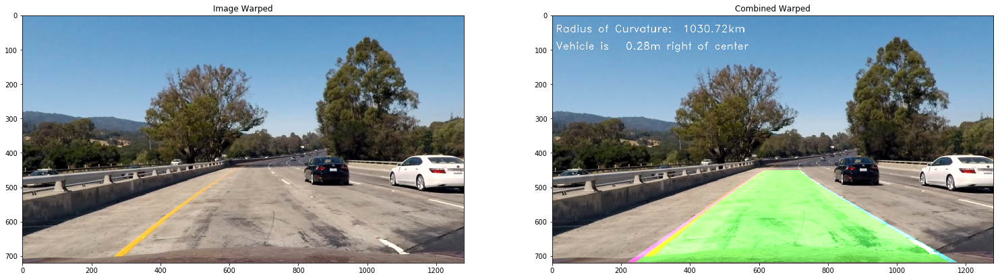

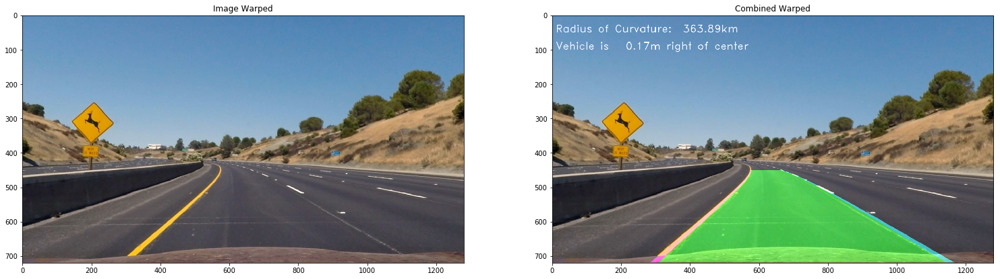

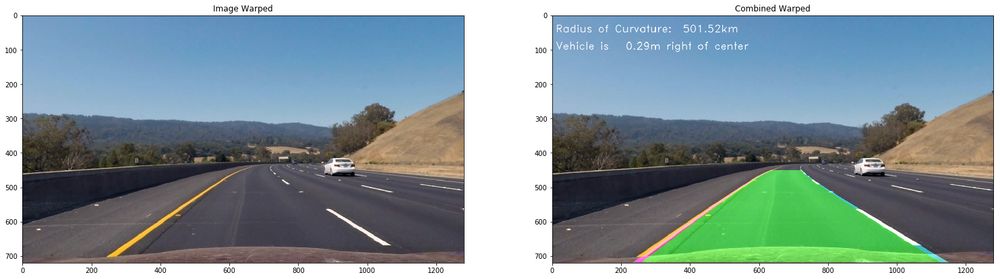

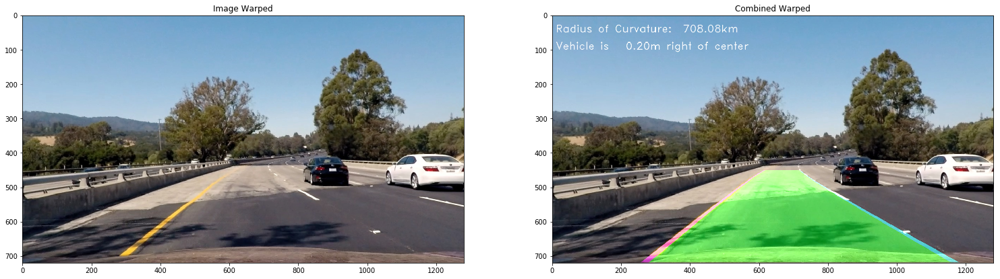

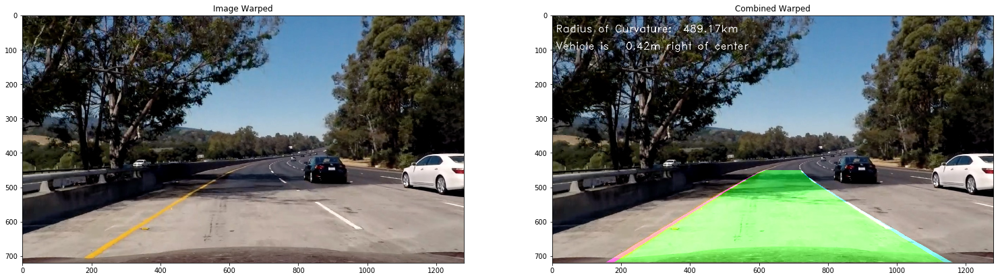

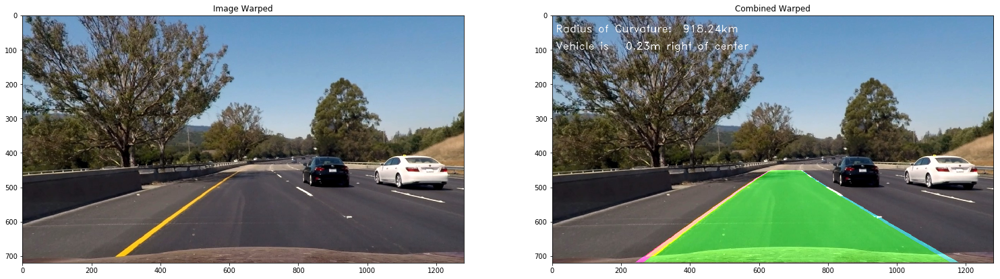

In [19]:
images = glob.glob('test_images/*.jpg') 

c = Camera()
c.calibrate()
t = Thresholds()
b = BirdEyeView_Transform()
l = Lanes()

def test_draw_lines_and_overlay_on_road(fname):
    image = cv2.imread(fname)
    image = c.undistort(image)
    combined = t.combine(image)
    image_warped = b.warp(image)
    combined_warped = b.warp(combined)
    l.find_lane_pixels(combined_warped, True)
    
    left_fitx, right_fitx, ploty = l.get_poly_plot()
    
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
    ax1.imshow(image)
    ax1.set_title('Image Warped')
    temp = draw_lines_on_road(image, combined_warped)
    curvature = l.curvature()
    car_distance = l.car_center_distance()
    temp = draw_overlay(temp, curvature, car_distance)
    ax2.imshow(temp)
    ax2.set_title('Combined Warped')
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.show()
    
for index, fname in enumerate(images):
    test_draw_lines_and_overlay_on_road(fname)